In [6]:
import torch
from torchvision import datasets, transforms
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import matplotlib.pyplot as plt
import os
from PIL import Image

In [7]:
class DeepVeilDataset(Dataset):
  def __init__(self, root_dir, split = "train"):
    self.root_dir = root_dir

    self.transform = transforms.Compose([
      transforms.Resize((128, 128)),
      transforms.ToTensor()
    ])

    self.image_files = [f for f in os.listdir(root_dir) if f.endswith(".png")]

  def __len__(self):
    return len(self.image_files)
  
  def __getitem__(self, index):
    path = os.path.join(self.root_dir, self.image_files[index])
    img = Image.open(path).convert('RGB')
    img_tensor = self.transform(img)
  
    secret_idx = (index + 1) % len(self.image_files)
    secret_path = os.path.join(self.root_dir, self.image_files[secret_idx])
        
    secret_img = Image.open(secret_path).convert('L') 
    secret_tensor = self.transform(secret_img)
        
    return img_tensor, secret_tensor

In [8]:
def get_loader(batch_size: int):
  dataset = DeepVeilDataset(root_dir = "./images/train_images")
  loader = DataLoader(dataset, batch_size = batch_size, shuffle = True, num_workers = 2)
  return loader

In [9]:
class DeepVeilEncoder(nn.Module):
  def __init__(self):
    super().__init__()

    #  there will be 4 channels (3 for cover, 1 for grayscale secret)
    self.layer1 = nn.Sequential(
      nn.Conv2d(4, 64, kernel_size = 3, padding = 1),
      nn.ReLU(inplace = True),
      nn.BatchNorm2d(64)
    )

    self.layer2 = nn.Sequential(
      nn.Conv2d(64, 128, kernel_size = 3, padding = 1),
      nn.ReLU(inplace = True),
      nn.BatchNorm2d(128)
    )

    self.layer3 = nn.Sequential(
      nn.Conv2d(128, 64, kernel_size = 3, padding = 1),
      nn.ReLU(inplace = True),
      nn.BatchNorm2d(64),
    )

    self.final = nn.Sequential(
      nn.Conv2d(64, 3, kernel_size = 3, padding = 1),
      nn.Sigmoid()
    )

  def forward(self, covers, secrets):
    x = torch.cat([covers, secrets], dim = 1)

    x = self.layer1(x)
    x = self.layer2(x)
    x = self.layer3(x)
    stego_image = self.final(x)

    return stego_image

In [10]:
class DeepVeilDecoder(nn.Module):
  def __init__(self):
    super().__init__()

    self.layer1 = nn.Sequential(
      nn.Conv2d(3, 64, kernel_size = 3, padding = 1),
      nn.ReLU(inplace = True),
      nn.BatchNorm2d(64)
    )

    self.layer2 = nn.Sequential(
      nn.Conv2d(64, 128, kernel_size = 3, padding = 1),
      nn.ReLU(inplace = True),
      nn.BatchNorm2d(128)
    )

    self.layer3 = nn.Sequential(
      nn.Conv2d(128, 64, kernel_size = 3, padding = 1),
      nn.ReLU(inplace = True),
      nn.BatchNorm2d(64),
    )

    self.final = nn.Sequential(
      nn.Conv2d(64, 1, kernel_size = 3, padding = 1),
      nn.Sigmoid()
    )

  def forward(self, stego_images):
    x = self.layer1(stego_images)
    x = self.layer2(x)
    x = self.layer3(x)
    extracted_secret = self.final(x)

    return extracted_secret

In [11]:
encoder = DeepVeilEncoder().cuda()
decoder = DeepVeilDecoder().cuda()
all_params = list(encoder.parameters()) + list(decoder.parameters())
optimizer = torch.optim.AdamW(all_params, lr = 0.001)
criterion = torch.nn.MSELoss()

Batch 0: 0 images processed...


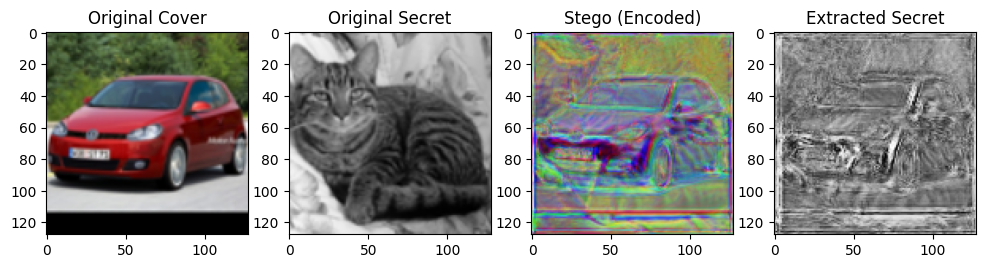

Batch 80: 640 images processed...


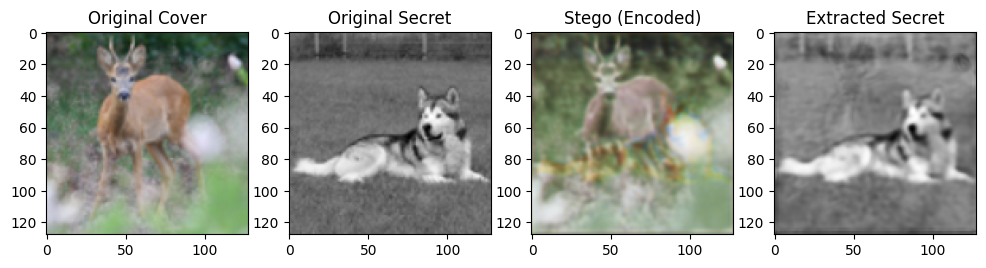

Batch 160: 1280 images processed...


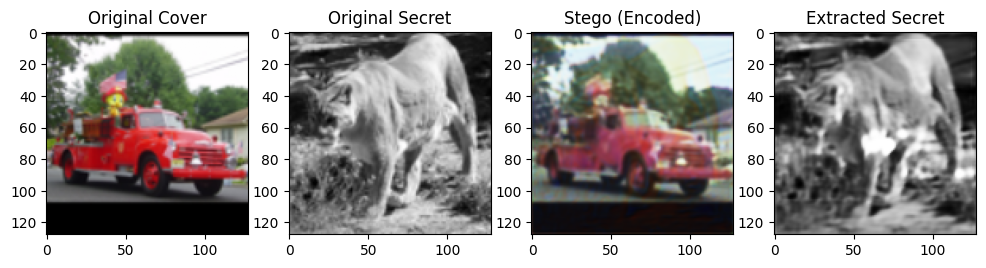

Batch 240: 1920 images processed...


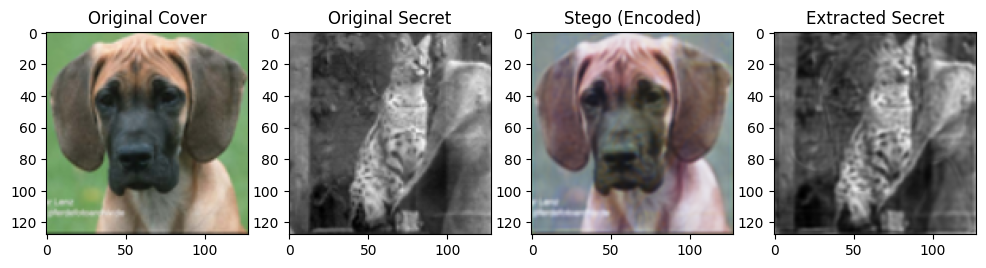

Batch 320: 2560 images processed...


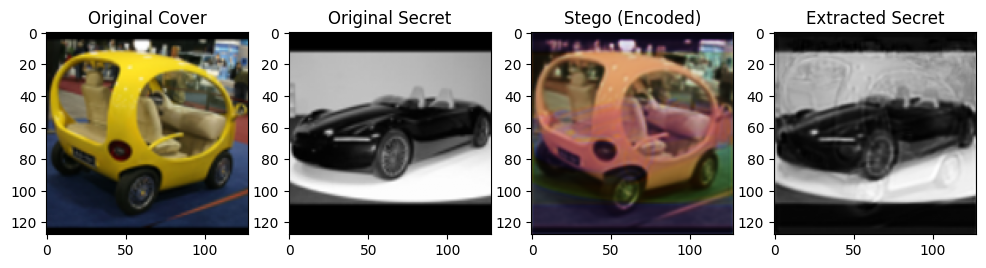

Batch 400: 3200 images processed...


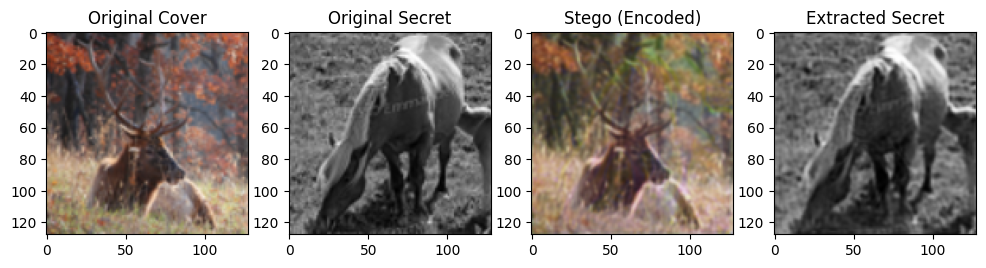

Batch 480: 3840 images processed...


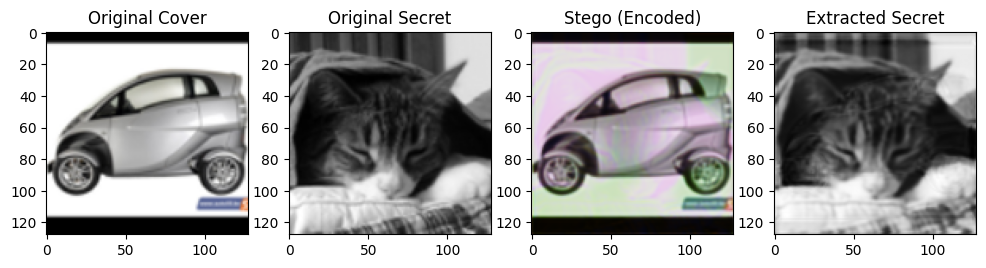

Batch 560: 4480 images processed...


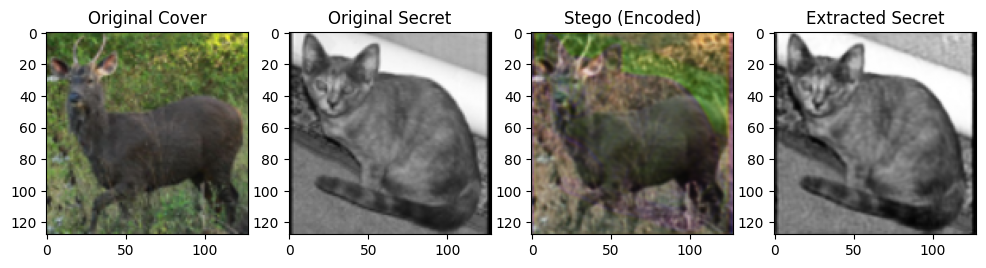

--- Epoch [1/10] Finished, Average Loss: 0.013696 ---
Batch 0: 0 images processed...


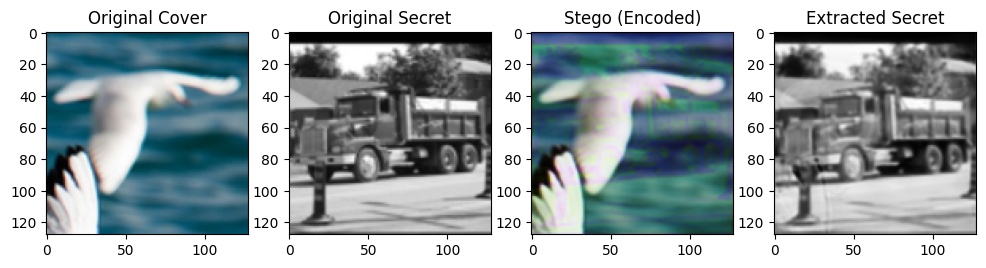

Batch 80: 640 images processed...


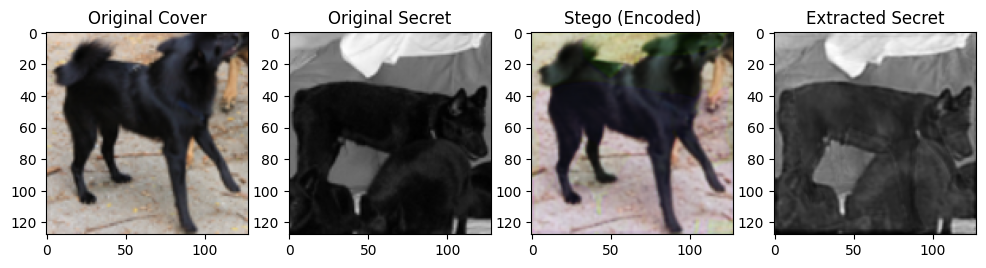

Batch 160: 1280 images processed...


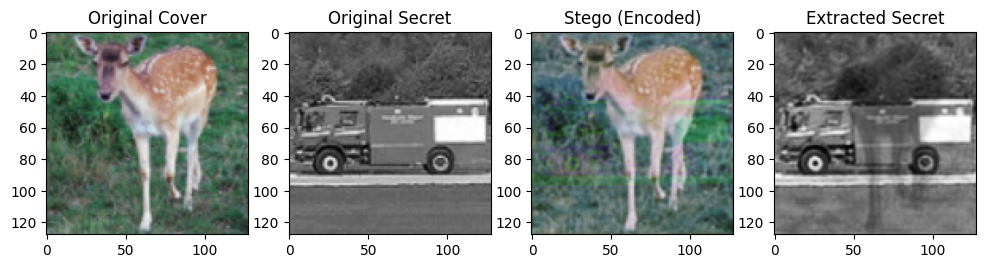

Batch 240: 1920 images processed...


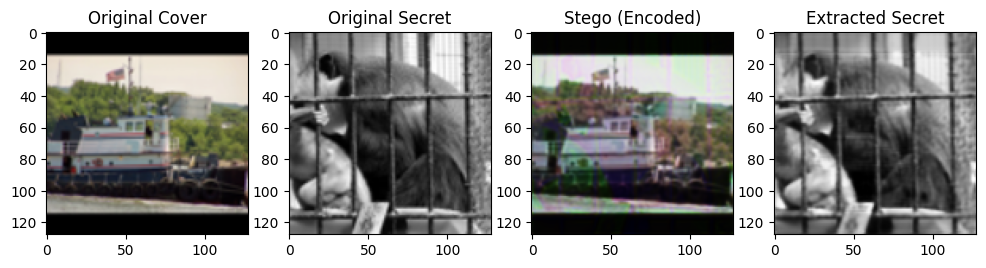

Batch 320: 2560 images processed...


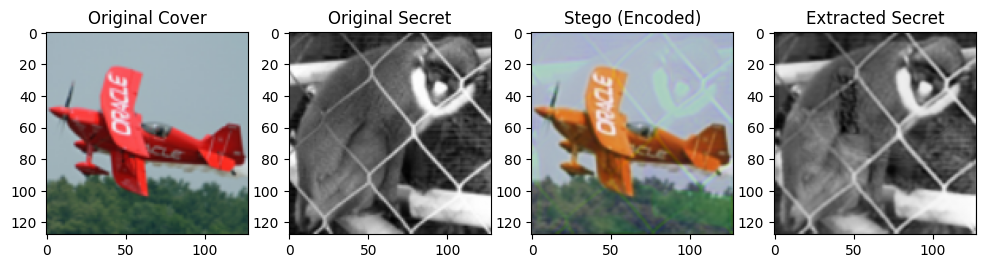

Batch 400: 3200 images processed...


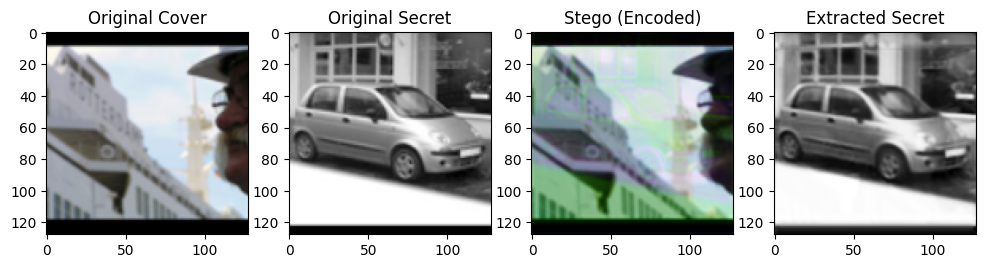

Batch 480: 3840 images processed...


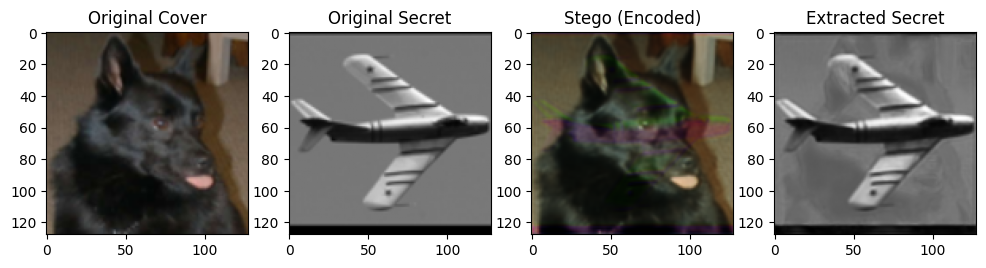

Batch 560: 4480 images processed...


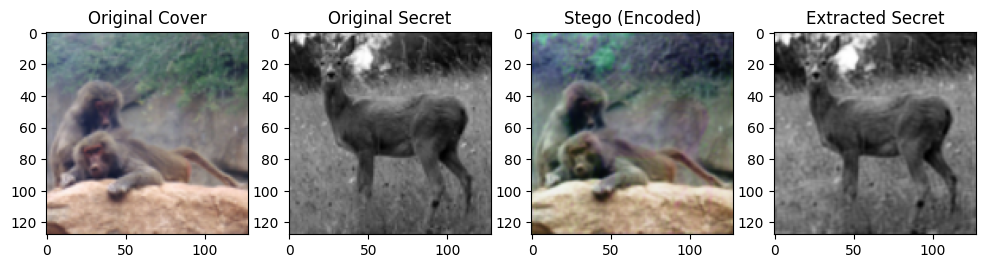

--- Epoch [2/10] Finished, Average Loss: 0.008384 ---
Batch 0: 0 images processed...


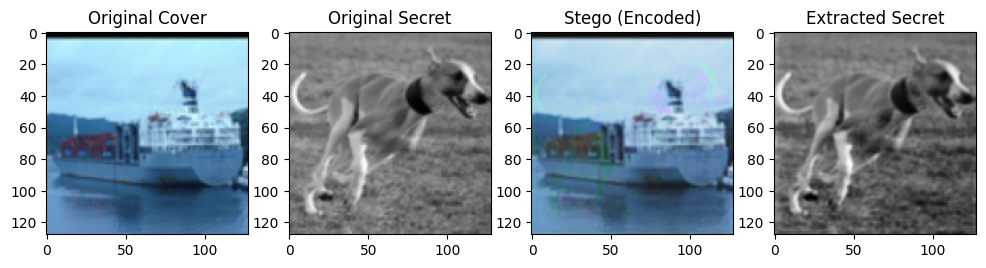

Batch 80: 640 images processed...


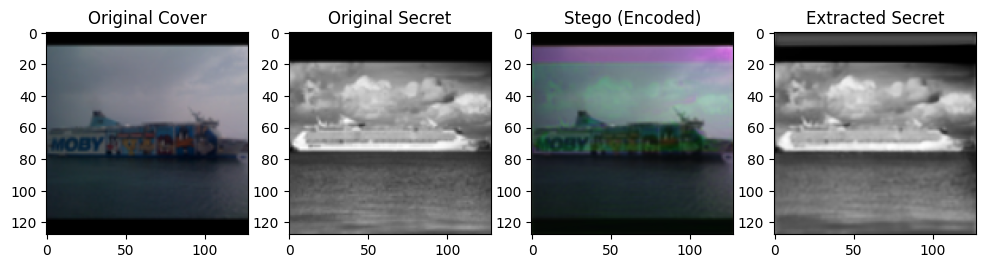

Batch 160: 1280 images processed...


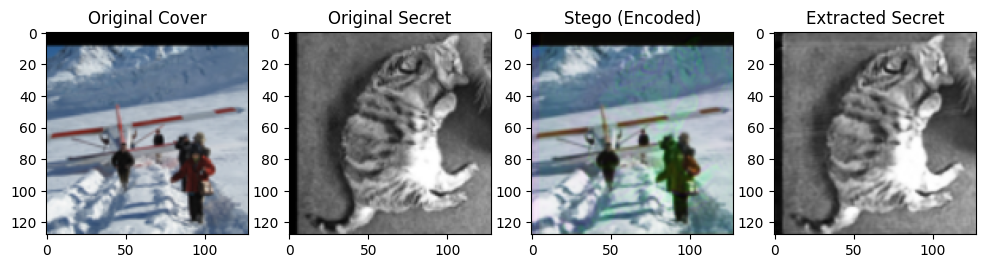

Batch 240: 1920 images processed...


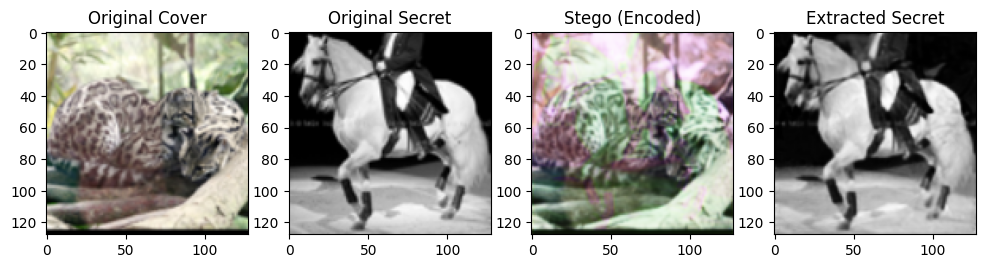

Batch 320: 2560 images processed...


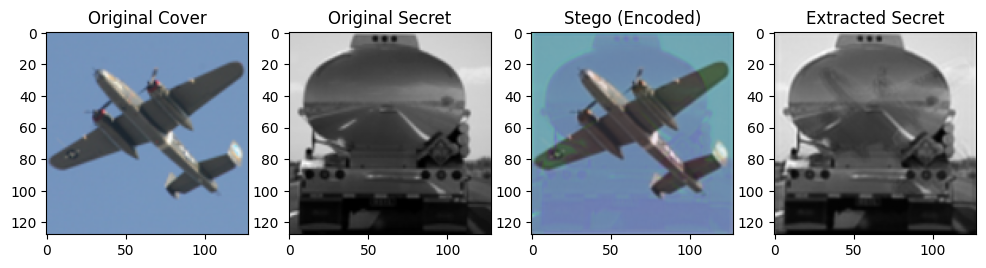

Batch 400: 3200 images processed...


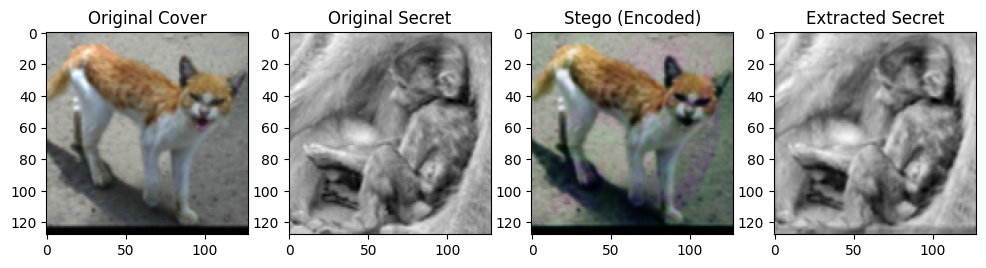

Batch 480: 3840 images processed...


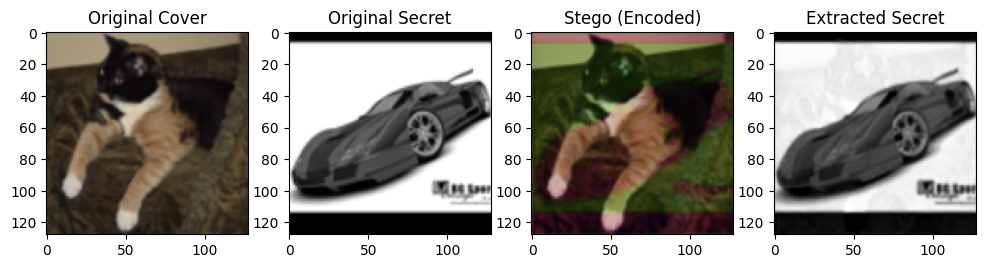

Batch 560: 4480 images processed...


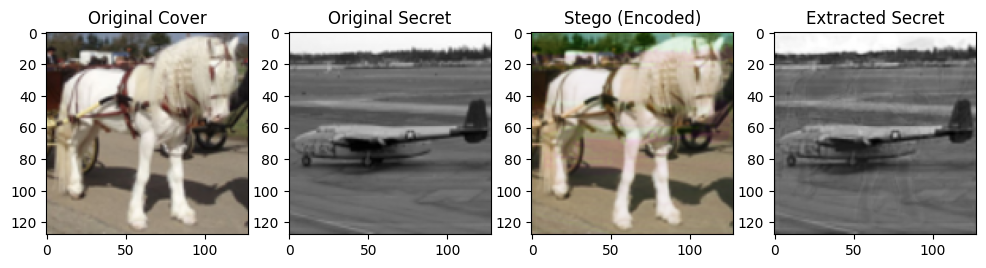

--- Epoch [3/10] Finished, Average Loss: 0.007310 ---
Batch 0: 0 images processed...


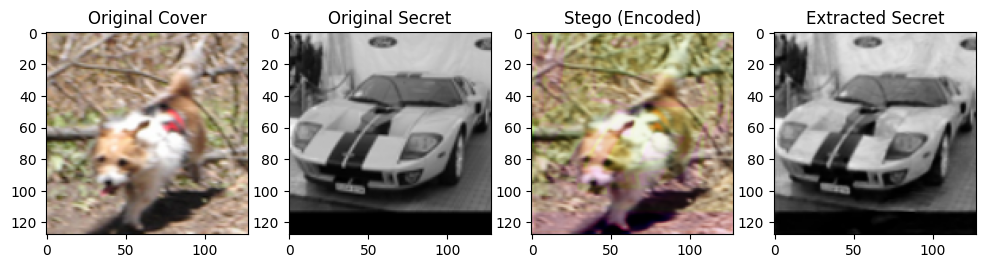

Batch 80: 640 images processed...


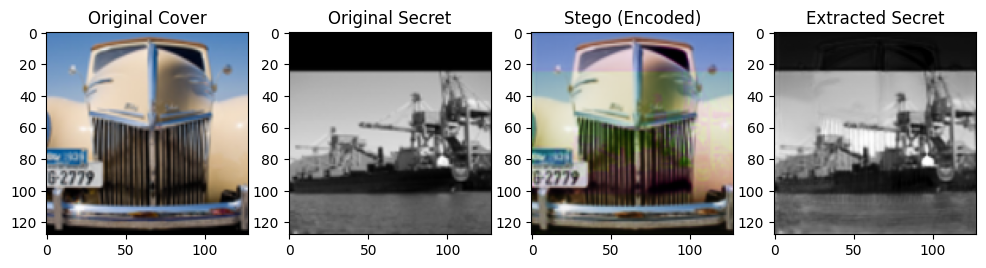

Batch 160: 1280 images processed...


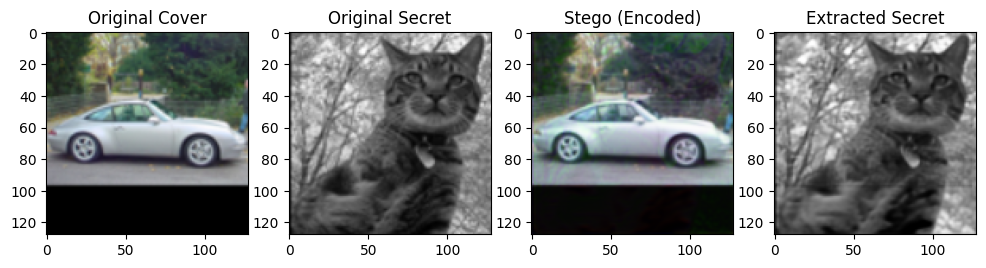

Batch 240: 1920 images processed...


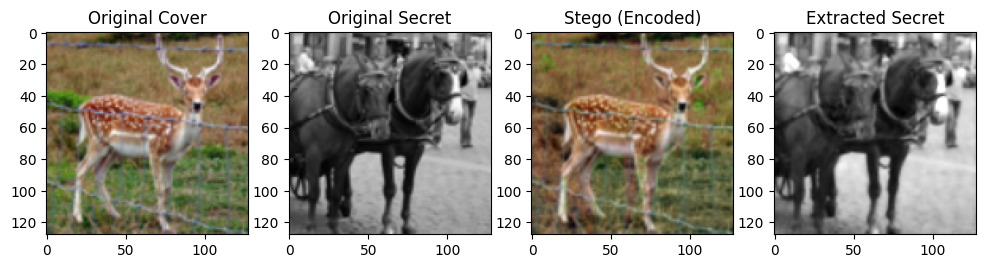

Batch 320: 2560 images processed...


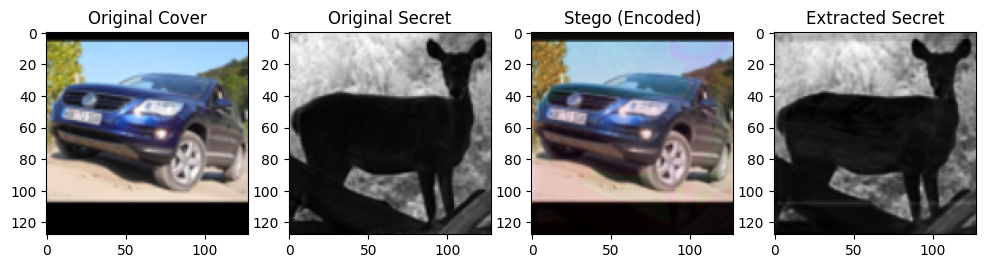

Batch 400: 3200 images processed...


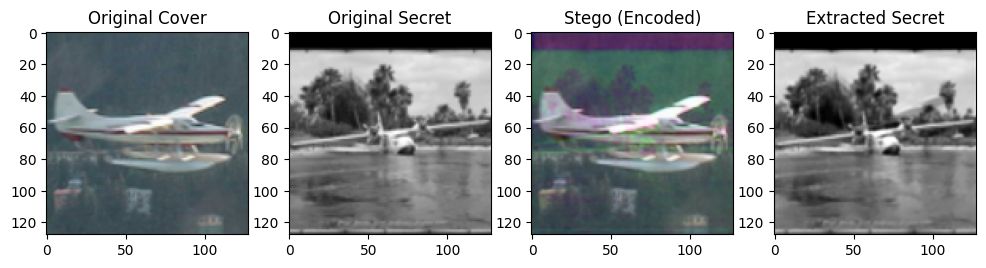

Batch 480: 3840 images processed...


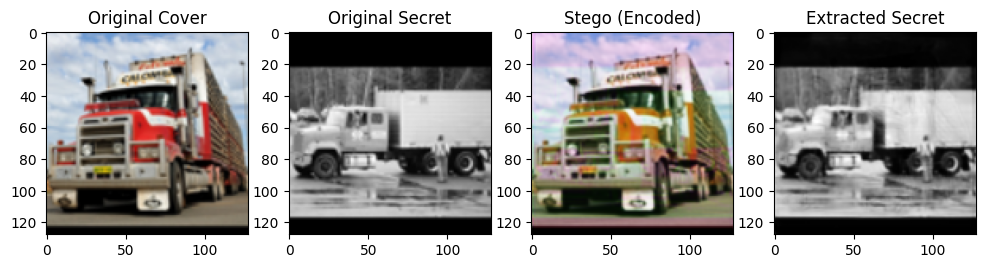

Batch 560: 4480 images processed...


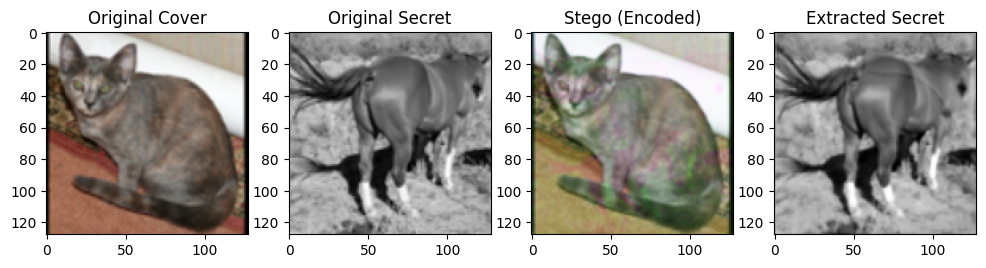

--- Epoch [4/10] Finished, Average Loss: 0.006657 ---
Batch 0: 0 images processed...


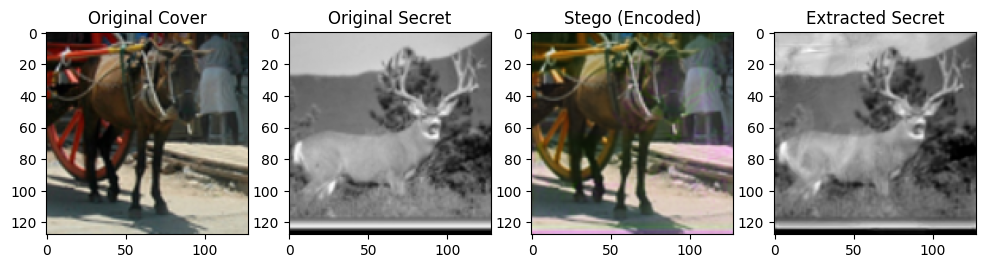

Batch 80: 640 images processed...


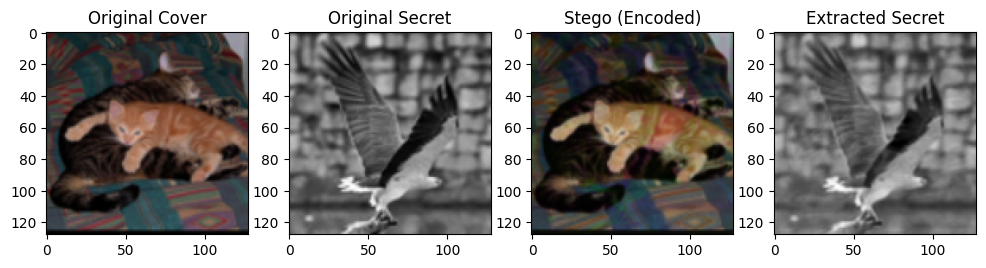

Batch 160: 1280 images processed...


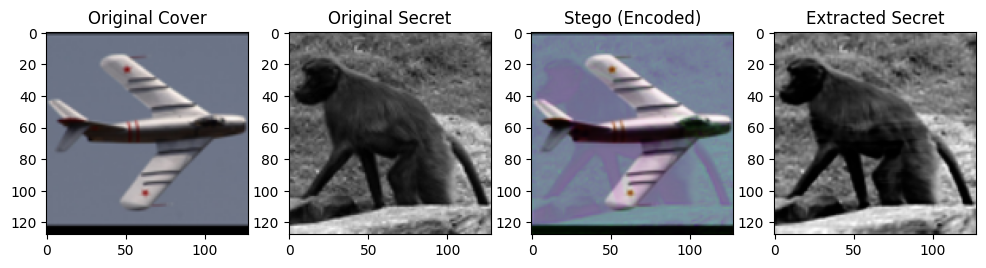

Batch 240: 1920 images processed...


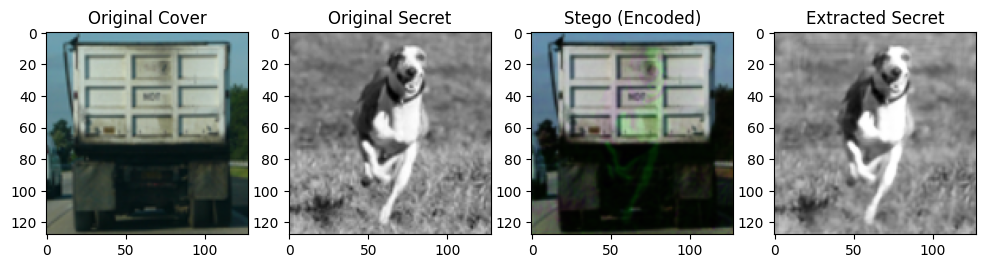

Batch 320: 2560 images processed...


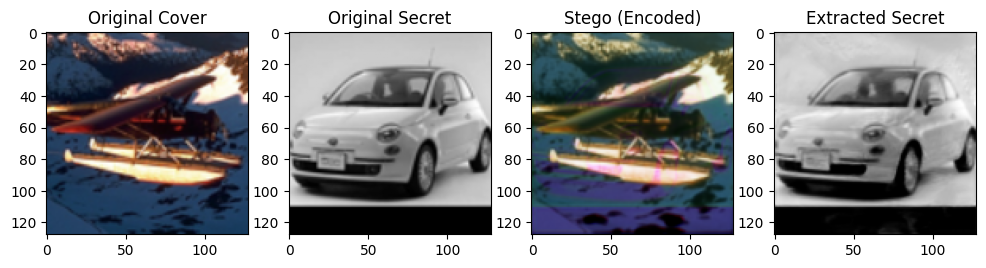

Batch 400: 3200 images processed...


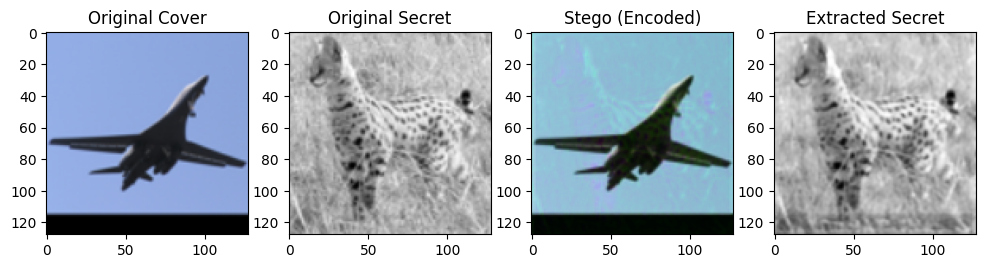

Batch 480: 3840 images processed...


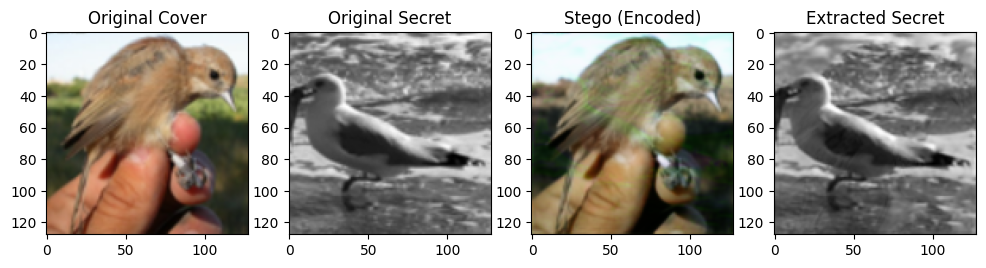

Batch 560: 4480 images processed...


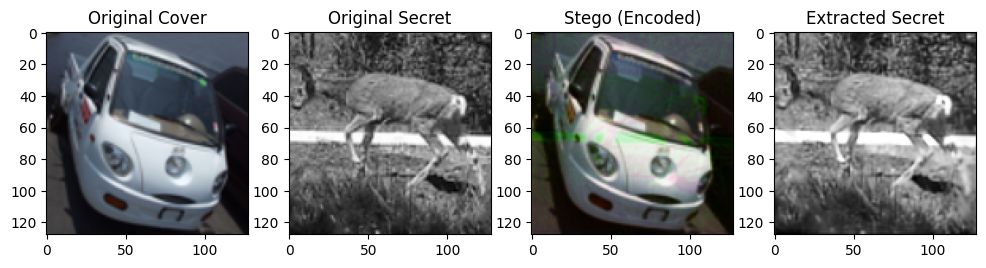

--- Epoch [5/10] Finished, Average Loss: 0.005955 ---
Batch 0: 0 images processed...


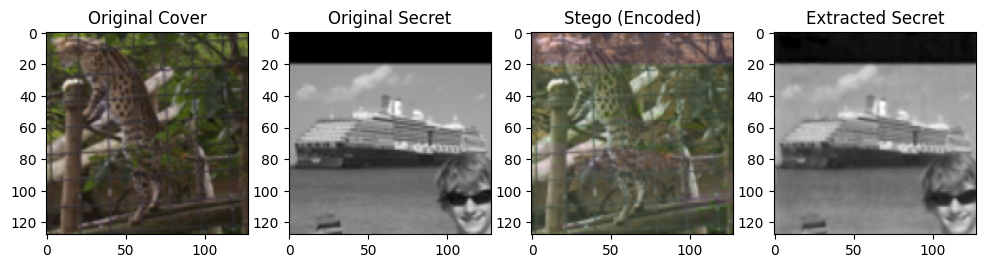

Batch 80: 640 images processed...


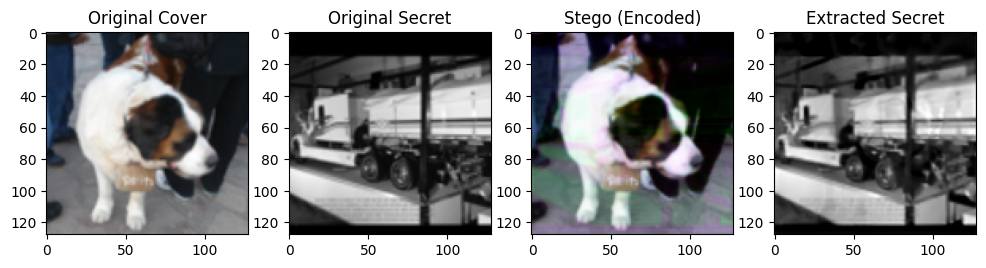

Batch 160: 1280 images processed...


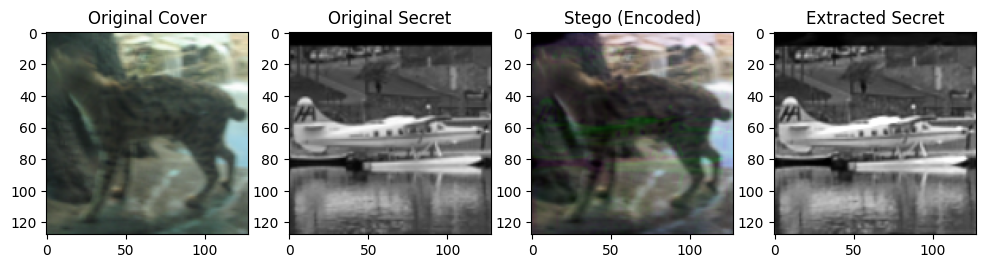

Batch 240: 1920 images processed...


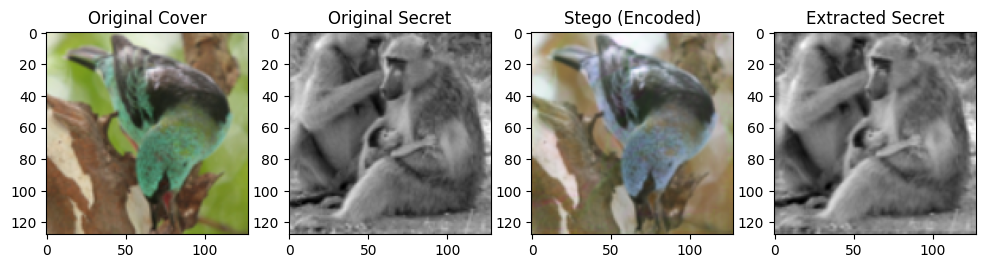

Batch 320: 2560 images processed...


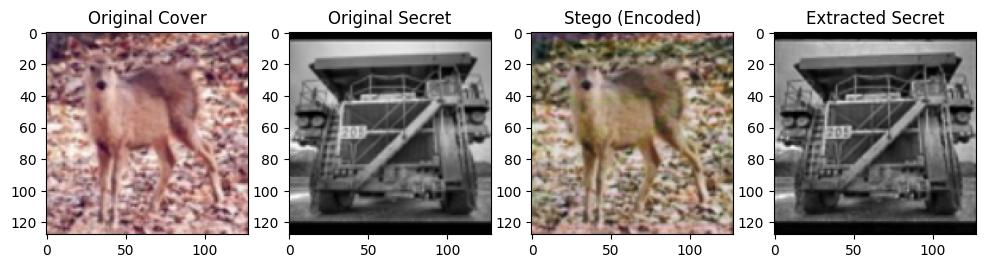

Batch 400: 3200 images processed...


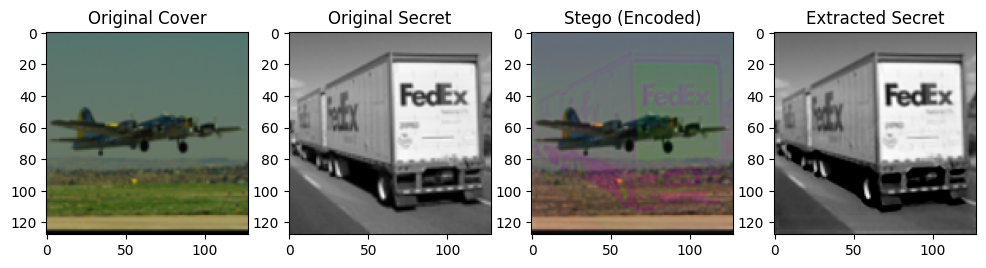

Batch 480: 3840 images processed...


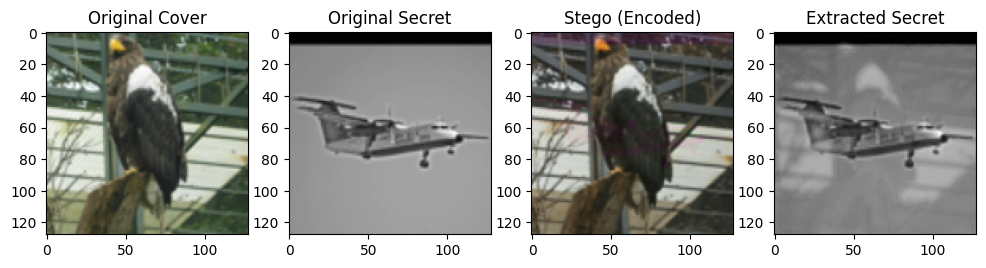

Batch 560: 4480 images processed...


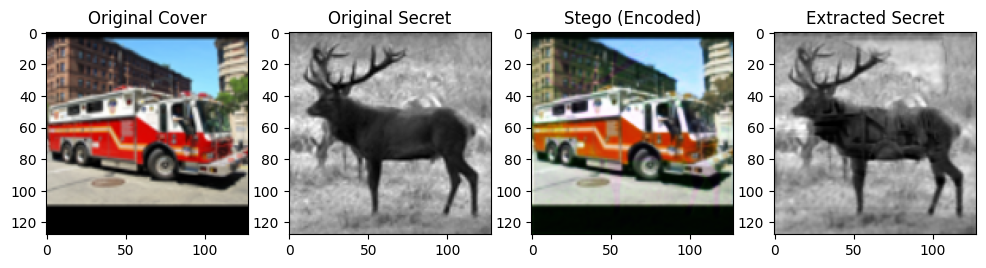

--- Epoch [6/10] Finished, Average Loss: 0.005495 ---
Batch 0: 0 images processed...


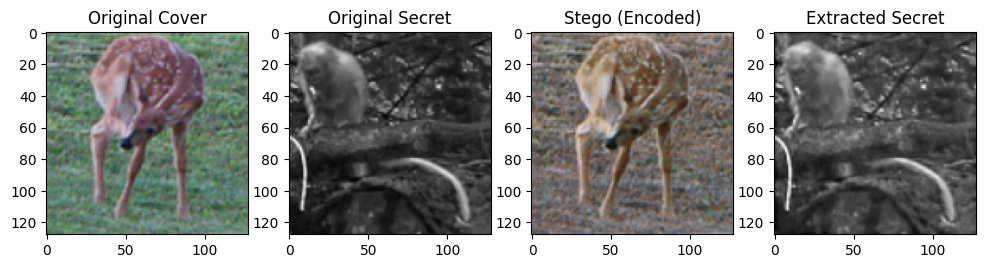

Batch 80: 640 images processed...


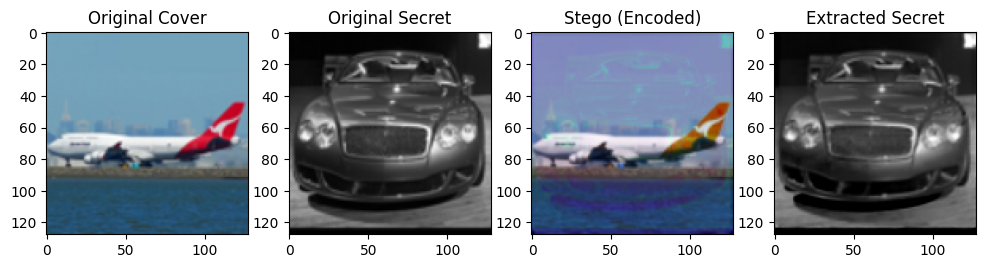

Batch 160: 1280 images processed...


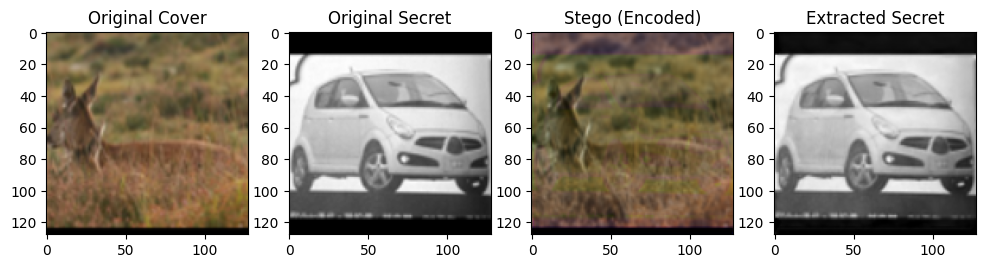

Batch 240: 1920 images processed...


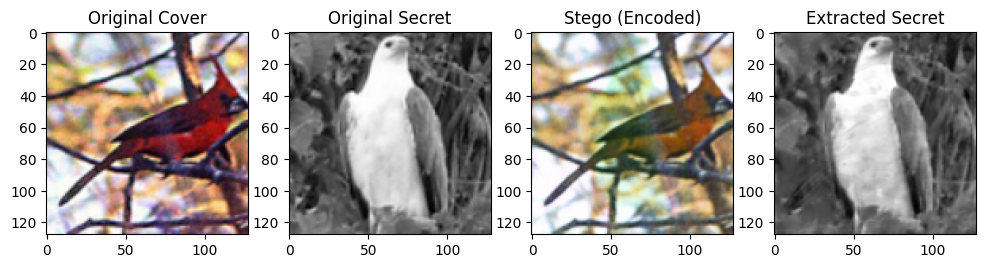

Batch 320: 2560 images processed...


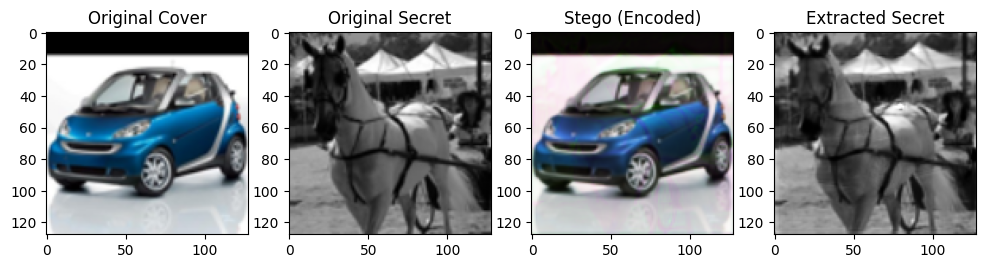

Batch 400: 3200 images processed...


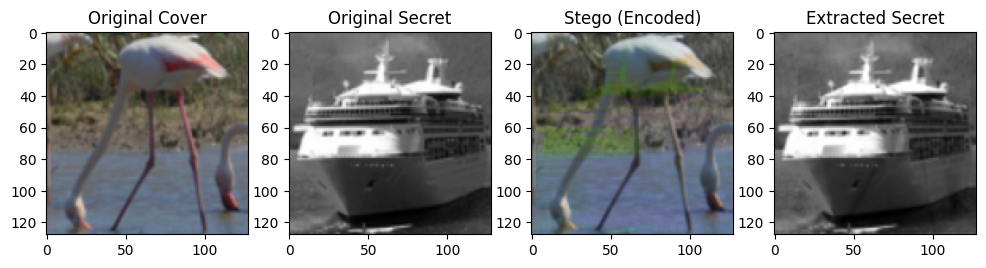

Batch 480: 3840 images processed...


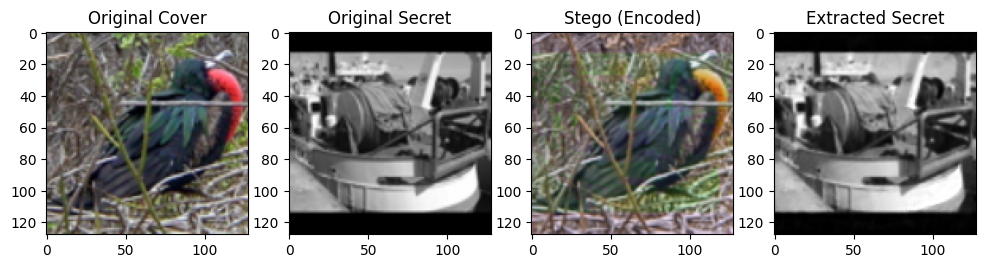

Batch 560: 4480 images processed...


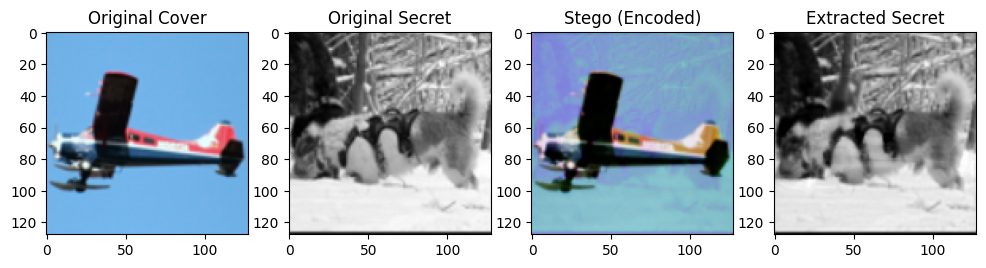

--- Epoch [7/10] Finished, Average Loss: 0.005364 ---
Batch 0: 0 images processed...


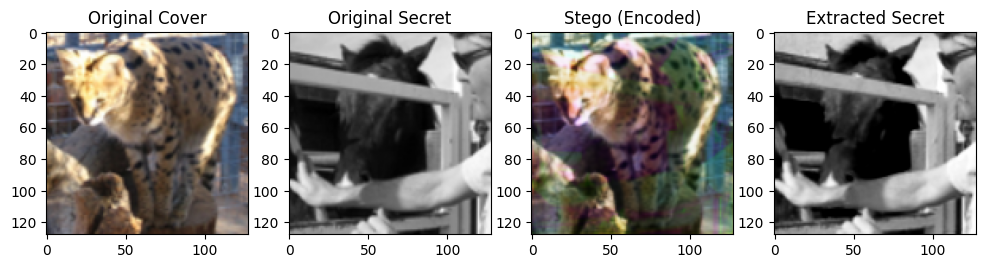

Batch 80: 640 images processed...


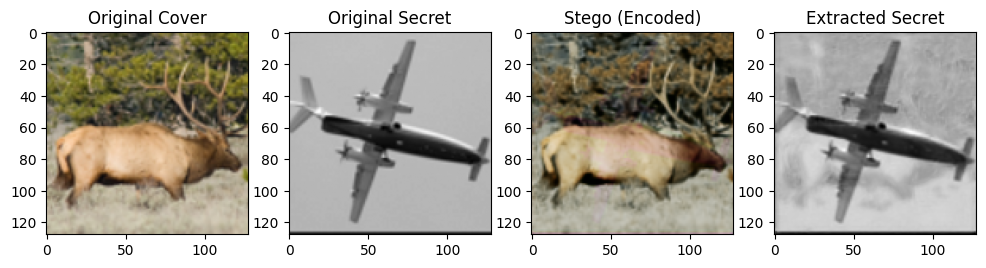

Batch 160: 1280 images processed...


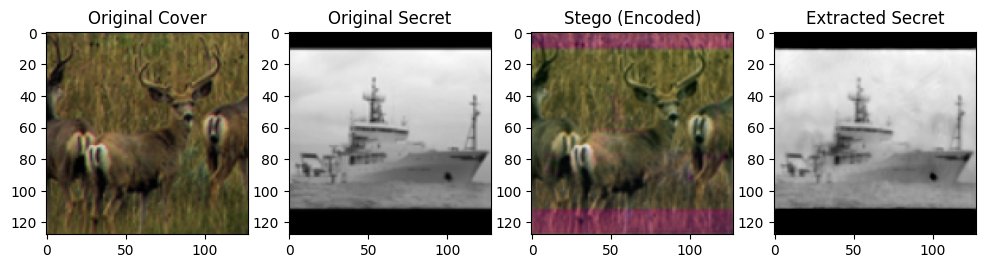

Batch 240: 1920 images processed...


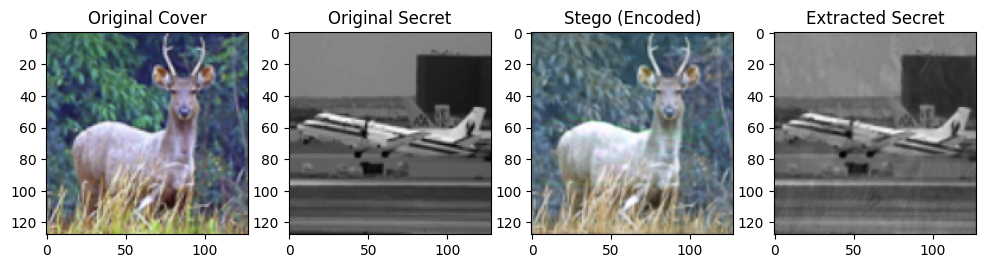

Batch 320: 2560 images processed...


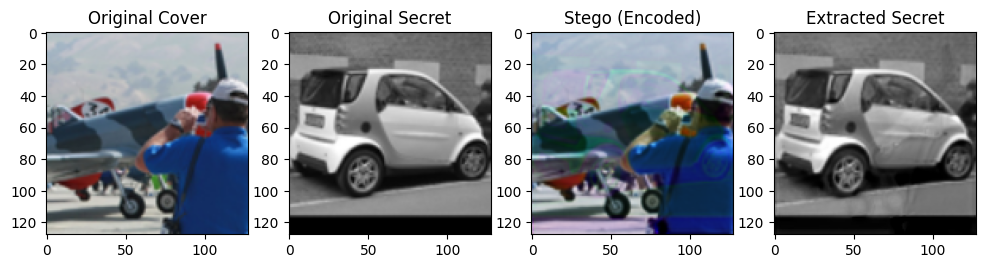

Batch 400: 3200 images processed...


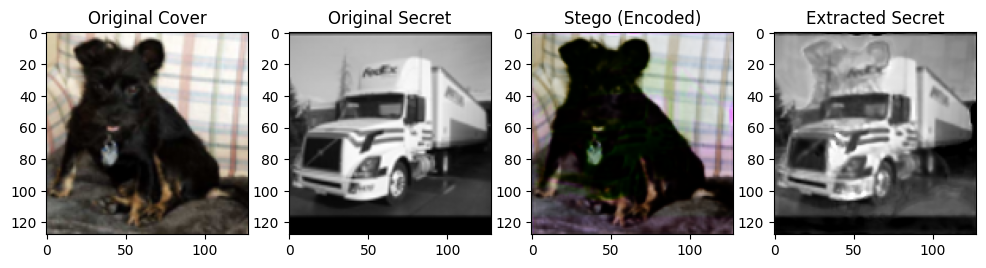

Batch 480: 3840 images processed...


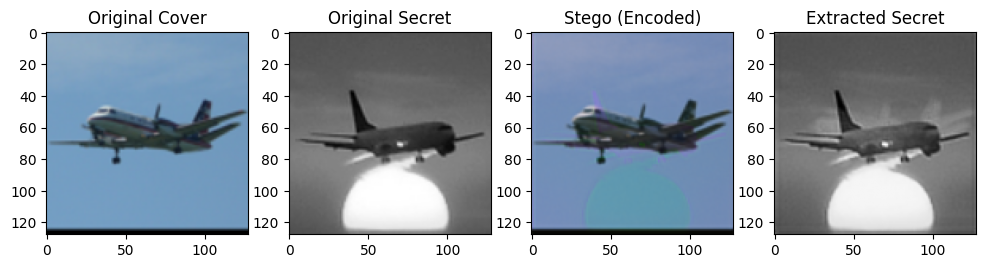

Batch 560: 4480 images processed...


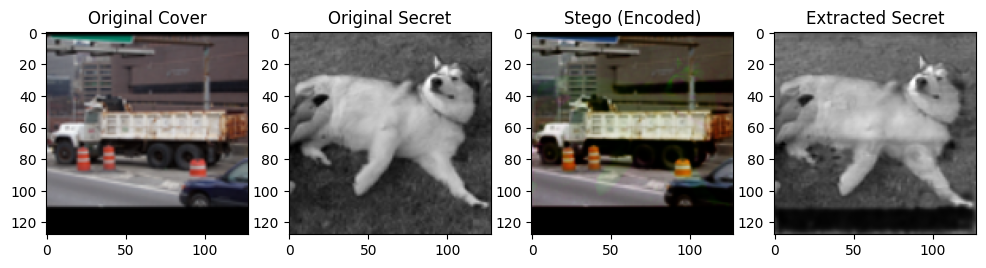

--- Epoch [8/10] Finished, Average Loss: 0.005129 ---
Batch 0: 0 images processed...


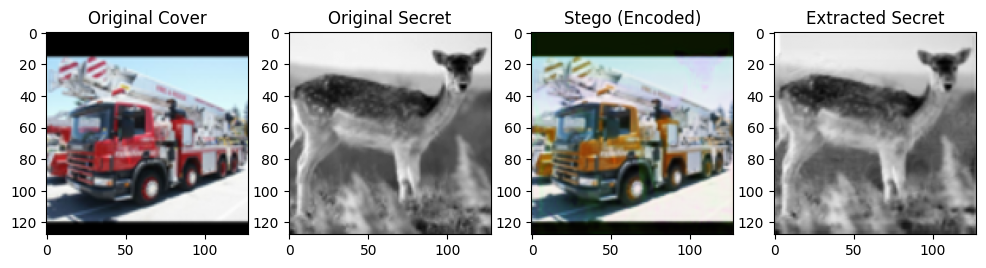

Batch 80: 640 images processed...


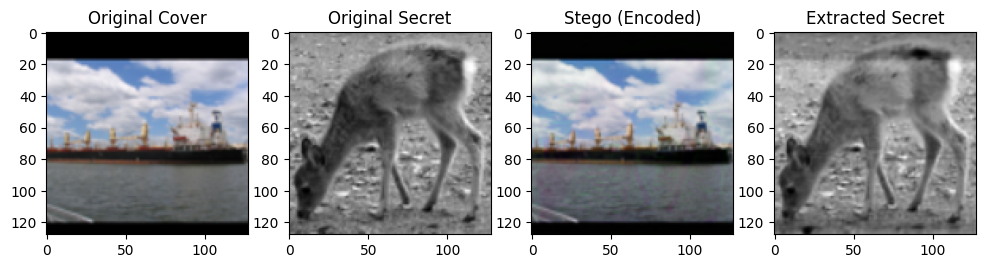

Batch 160: 1280 images processed...


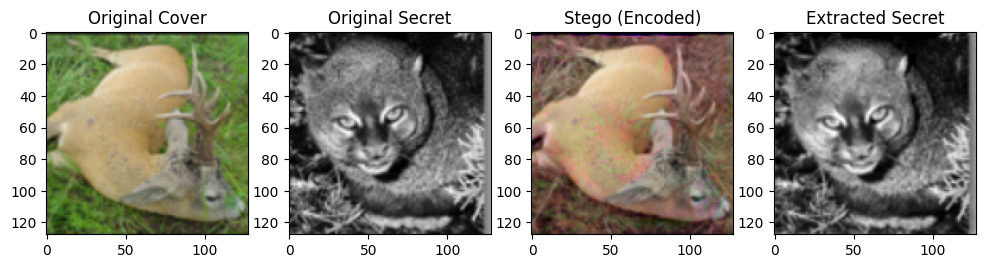

Batch 240: 1920 images processed...


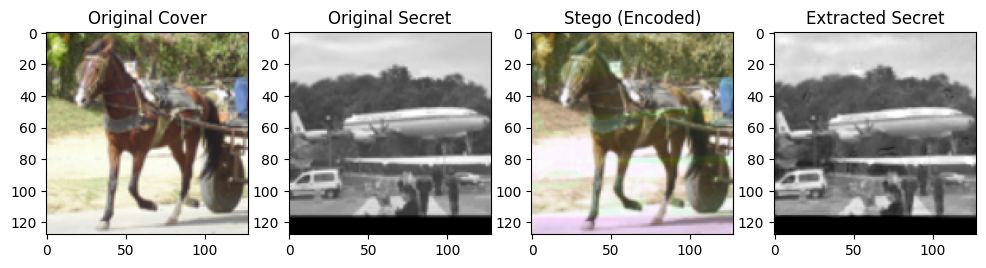

Batch 320: 2560 images processed...


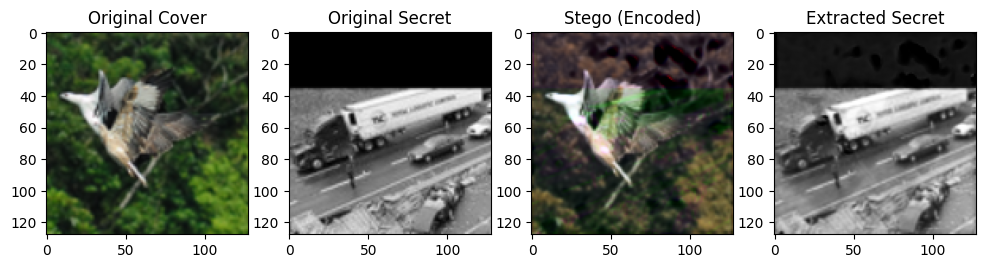

Batch 400: 3200 images processed...


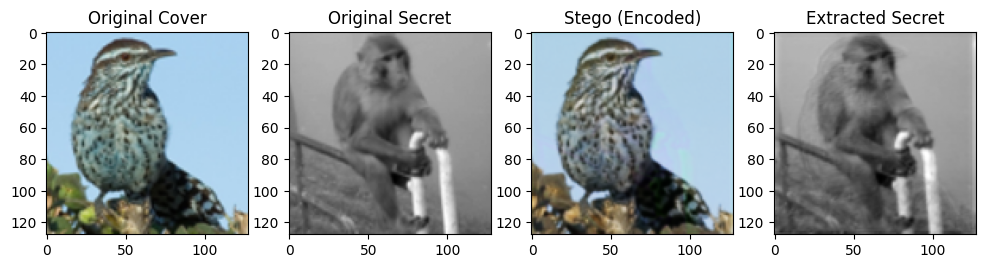

Batch 480: 3840 images processed...


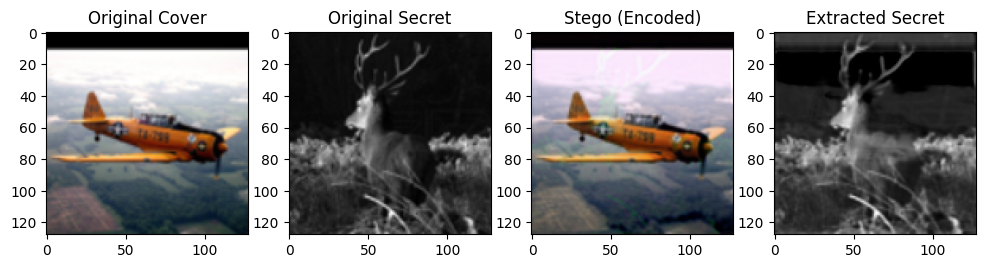

Batch 560: 4480 images processed...


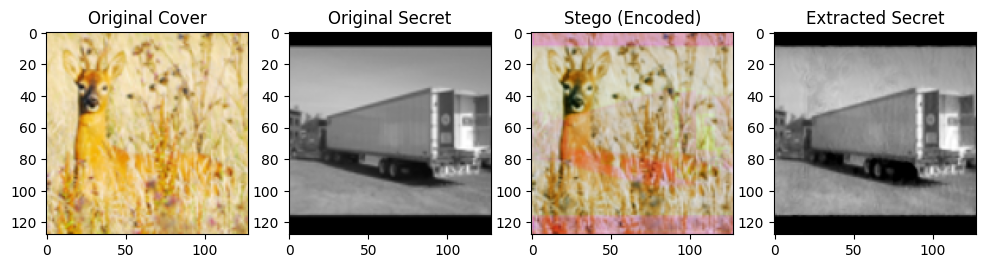

--- Epoch [9/10] Finished, Average Loss: 0.004685 ---
Batch 0: 0 images processed...


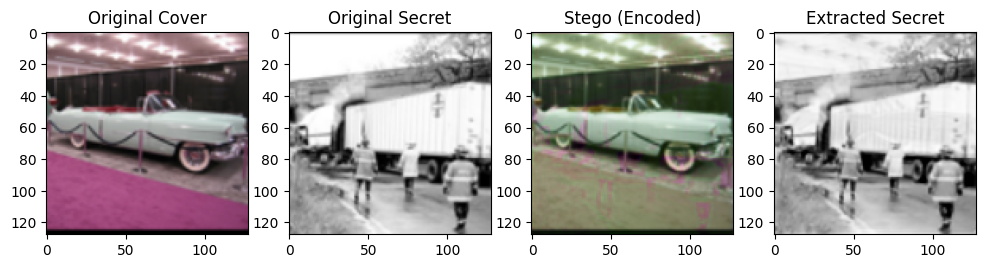

Batch 80: 640 images processed...


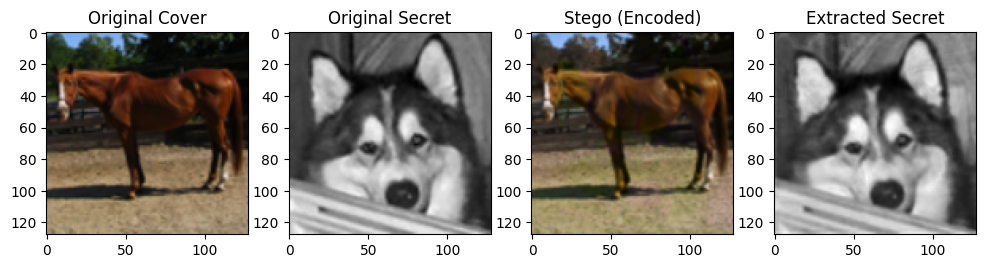

Batch 160: 1280 images processed...


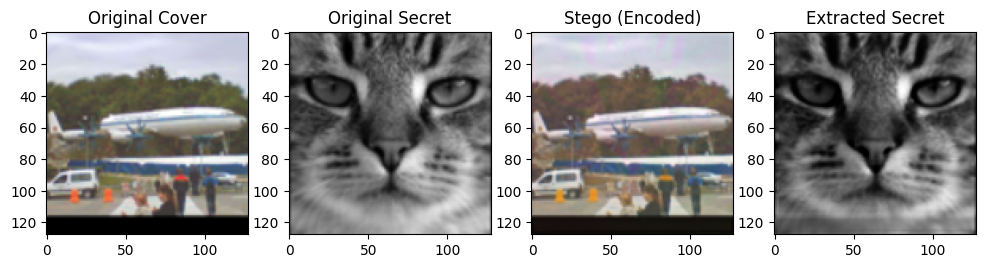

Batch 240: 1920 images processed...


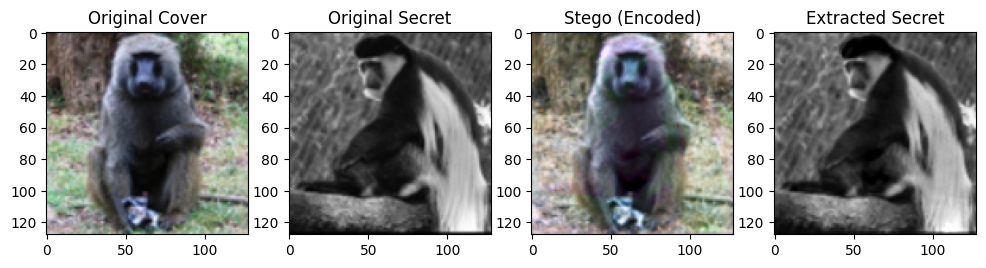

Batch 320: 2560 images processed...


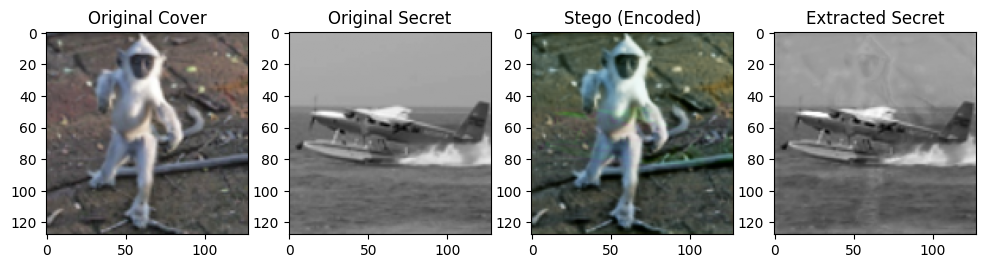

Batch 400: 3200 images processed...


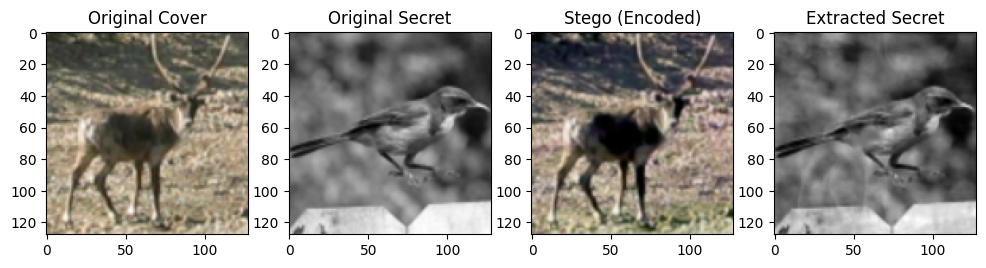

Batch 480: 3840 images processed...


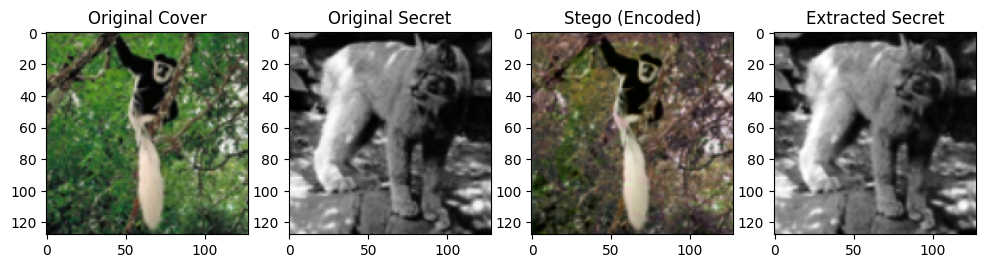

Batch 560: 4480 images processed...


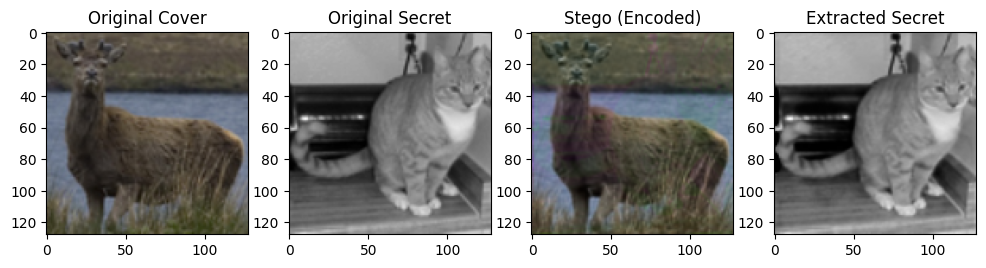

--- Epoch [10/10] Finished, Average Loss: 0.004576 ---


In [12]:
train_loader = get_loader(8)
batch_size = 8

for epoch in range(10):
    running_loss = 0.0  # Reset only at the start of the epoch
    
    for i, (covers, secrets) in enumerate(train_loader):
        covers = covers.cuda()
        secrets = secrets.cuda()

        stego_images = encoder(covers, secrets)
        extracted_secrets = decoder(stego_images)

        encoder_loss = criterion(stego_images, covers)
        decoder_loss = criterion(extracted_secrets, secrets)
        total_loss = encoder_loss + decoder_loss

        optimizer.zero_grad()
        total_loss.backward()
        optimizer.step()
        
        running_loss += total_loss.item()

        # Logic to show images every 500 images (approx every 62 batches)
        if i % 80 == 0:
            print(f"Batch {i}: {i * batch_size} images processed...")
            with torch.no_grad(): 
                cv = covers[0].cpu().permute(1, 2, 0)
                sc = secrets[0].cpu().squeeze()
                st = stego_images[0].cpu().permute(1, 2, 0)
                ex = extracted_secrets[0].cpu().squeeze()

                plt.figure(figsize=(12, 3)) # Height adjusted to 3 for better layout
                plt.subplot(1, 4, 1); plt.title("Original Cover"); plt.imshow(cv)
                plt.subplot(1, 4, 2); plt.title("Original Secret"); plt.imshow(sc, cmap='gray')
                plt.subplot(1, 4, 3); plt.title("Stego (Encoded)"); plt.imshow(st)
                plt.subplot(1, 4, 4); plt.title("Extracted Secret"); plt.imshow(ex, cmap='gray')
                plt.show()

    # Print epoch summary
    avg_loss = running_loss / len(train_loader)
    print(f"--- Epoch [{epoch+1}/10] Finished, Average Loss: {avg_loss:.6f} ---")

In [13]:
# Save Encoder and Decoder weights
torch.save(encoder.state_dict(), 'encoder_weights.pth')
torch.save(decoder.state_dict(), 'decoder_weights.pth')

print("Model weights saved successfully.")

Model weights saved successfully.


In [15]:
import torch
from PIL import Image
from torchvision import transforms

# 1. Setup transformations
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor()
])

# 2. Load and Prepare Images
def prepare_image(image_path):
    img = Image.open(image_path).convert('RGB')
    return transform(img).unsqueeze(0).cuda() 

def prepare_secret(image_path):
    img = Image.open(image_path).convert('L')
    return transform(img).unsqueeze(0).cuda() 

cover_t = prepare_image("cover.jpeg")
secret_t = prepare_secret("secret.jpeg")

# 3. Load Models
encoder = DeepVeilEncoder().cuda()
decoder = DeepVeilDecoder().cuda()
encoder.load_state_dict(torch.load('encoder_weights.pth'))
decoder.load_state_dict(torch.load('decoder_weights.pth'))

# 4. Set to Eval Mode (Important for BatchNorm/Dropout)
encoder.eval()
decoder.eval()

# 5. Run Inference
with torch.no_grad():
    stego_image = encoder(cover_t, secret_t)
    extracted_secret = decoder(stego_image)

# 6. Save or Show Result
from torchvision.utils import save_image
save_image(stego_image, "output_stego.png")
save_image(extracted_secret, "output_extracted.png")